In [41]:
# Python basics & calculus
import numpy as np
import pyarrow as pa
import pyarrow.parquet as pq
from datetime import datetime, timedelta

# ETL
import pandas as pd
import sklearn as scl

# visualization
import bokeh
from dataprep.eda import create_report
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import HTML

# models
import skl2onnx
import xgboost
from xgboost.sklearn import XGBRegressor

from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression, RidgeClassifier, LinearRegression
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.tree import DecisionTreeClassifier


# Ethics & Fairness
import aif360
import shap


In [2]:
# configure Jupyter displays
%matplotlib inline

pd.set_option("display.max_rows", 128)
pd.set_option("display.max_columns", 32)
pd.set_option("precision", 3)


In [3]:
# CONSTANTS
DATE_DATETIME_FORMAT = '%Y-%m-%d, %H:%M:%S'
DATE_DATEONLY_FORMAT = '%Y-%m-%d'
DATE_YEAR_MONTH_FORMAT = '%Y-%m'
DATE_DATA_COLLECTION = datetime(2021, 1, 1)
DATE_WEEKS_PER_MONTH = 4.34

# UTIL FUNCTIONS
def get_formatted_date(date, 
                       format_string=DATE_DATETIME_FORMAT):
    """
    Return nothing (`void`) for invalid date instances. Return the 
    pretty-formatted date for valid dates. The default format string 
    may be replaced in the field `format_string`.
    """
    return date.strftime(format_string) if date else None

def is_natural_number(number):
    if (type(number) != int) or (type(number) == bool) or (not number):
        return None
    
    if number == 0:
        return True
    
    return number % 1 == 0

def get_year_month_from_offset_as_date(date, 
                                       offset_months=0,
                                       weeks_per_month=DATE_WEEKS_PER_MONTH,
                                       reset_to_first_of_month=True,
                                       format_string=None):
    """
    Return a date instance relative to `date` a couple of months 
    in the past w/ positive values in `offset_months`. Dates 
    relative to `date` in the future use negative values 
    in `offset_months`. When `reset_to_first_of_month` is `True`, 
    the returned `datetime` instance will be first of this month 
    with hours, minutes and seconds set to zero each. 
    When giving no format string to `format_string`, an instance of 
    `datetime` will be returned. When providing it, a string will 
    be returned in the specified format. This date text format 
    will not be further checked.
    If no valid date instance is given, 
    `void` is being returned.
    """
    # check for @NotNull
    if not date:
        return None
    
    # calculate weeks to go backwards into the past (-) or future (+)
    weeks = offset_months * weeks_per_month
    past_date = date + timedelta(weeks=weeks)
    
    # reset to 1st of month and time to 00:00:00
    if reset_to_first_of_month:
        past_date = datetime(past_date.year, past_date.month, 1)
        
    # possibly format the instance of `datetime` to text
    if (type(format_string) == str) and 0 < len(format_string):
        past_date = get_formatted_date(date=past_date, format_string=format_string)
    
    return past_date


In [4]:
card_balances_pq = pq.read_table('../data/processed/credit_card_balances.parquet')
card_balances = card_balances_pq.to_pandas()
card_balances.head()

,id,months_balance,status_code,year_month
0,5001711,0,X,2021-01-01
1,5001711,-1,0,2020-12-01
2,5001711,-2,0,2020-11-01
3,5001711,-3,0,2020-10-01
4,5001712,0,C,2021-01-01


In [5]:
apps_pq = pq.read_table('../data/processed/credit_masterdata.parquet')
apps = apps_pq.to_pandas()
apps.head()

,id,gender_code,family_status,has_own_car,has_own_real_estate,amount_income_total,income_type,education_type,housing_type,days_since_birth,days_tenure,has_private_mobile_phone,has_work_phone,has_phone,has_email,occupation_type,number_children,number_family_members,customer_lifetime_value,cltv_class,cltv_binary
0,5008804,M,Civil marriage,Y,Y,427500.0,Working,Higher education,Rented apartment,-12005,-4542,1,1,0,0,None,0,2.0,-23.0,medium,1
1,5008805,M,Civil marriage,Y,Y,427500.0,Working,Higher education,Rented apartment,-12005,-4542,1,1,0,0,None,0,2.0,-29.0,medium,1
2,5008806,M,Married,Y,Y,112500.0,Working,Secondary / secondary special,House / apartment,-21474,-1134,1,0,0,0,Security staff,0,2.0,-1528.0,watch,-1
3,5008808,F,Single / not married,N,Y,270000.0,Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1.0,-293.0,medium,1
4,5008809,F,Single / not married,N,Y,270000.0,Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1.0,-495.0,medium,1


In [6]:
apps.shape

(36424, 21)

In [7]:
apps.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36424 entries, 0 to 434812
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id                        36424 non-null  int64  
 1   gender_code               36424 non-null  object 
 2   family_status             36424 non-null  object 
 3   has_own_car               36424 non-null  object 
 4   has_own_real_estate       36424 non-null  object 
 5   amount_income_total       36424 non-null  float64
 6   income_type               36424 non-null  object 
 7   education_type            36424 non-null  object 
 8   housing_type              36424 non-null  object 
 9   days_since_birth          36424 non-null  int64  
 10  days_tenure               36424 non-null  int64  
 11  has_private_mobile_phone  36424 non-null  int64  
 12  has_work_phone            36424 non-null  int64  
 13  has_phone                 36424 non-null  int64  
 14  has_e

In [8]:
apps.describe()

,id,amount_income_total,days_since_birth,days_tenure,has_private_mobile_phone,has_work_phone,has_phone,has_email,number_children,number_family_members,customer_lifetime_value,cltv_binary
count,3.642e+04,3.642e+04,36424.000,36424.000,36424.0,36424.000,36424.000,36424.000,36424.000,36424.000,36424.000,36424.000
mean,5.078e+06,1.867e+05,-15976.082,59268.190,1.0,0.226,0.295,0.090,0.430,2.199,-331.434,0.666
std,4.188e+04,1.018e+05,4200.792,137656.444,0.0,0.418,0.456,0.286,0.742,0.912,884.750,0.746
min,5.009e+06,2.700e+04,-25152.000,-15713.000,1.0,0.000,0.000,0.000,0.000,1.000,-6039.000,-1.000
25%,5.042e+06,1.215e+05,-19438.250,-3153.000,1.0,0.000,0.000,0.000,0.000,2.000,-217.000,1.000
50%,5.075e+06,1.575e+05,-15563.000,-1552.000,1.0,0.000,0.000,0.000,0.000,2.000,3.500,1.000
75%,5.115e+06,2.250e+05,-12462.750,-408.000,1.0,0.000,1.000,0.000,1.000,3.000,71.000,1.000
max,5.150e+06,1.575e+06,-7489.000,365243.000,1.0,1.000,1.000,1.000,19.000,20.000,354.000,1.000


Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
Computing series-min-chunk-8a12ceebecd7b2aeee56557774c93c98:  40%|####      | 975/2423 [02:28<00:14, 97.63it/s]                                       Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
Computing series-sum-agg-2edf6d2ac4bdd01fe0686ec84d9d8b1b:  53%|#####3    | 1294/2423 [02:28<00:04, 226.81it/s]  Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
Boolean i

DataPrep Report
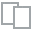
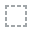
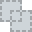
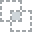
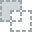
...
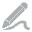
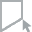
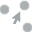
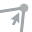
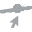

In [9]:
apps_dossier1 = create_report(apps)
apps_dossier1

In [10]:
apps_dossier2 = ProfileReport(apps, title="EDA Report for Bank Account's Master Data")
apps_dossier2

Render HTML: 100%|##########| 1/1 [00:03<00:00,  3.03s/it]


In [11]:
apps.head()

,id,gender_code,family_status,has_own_car,has_own_real_estate,amount_income_total,income_type,education_type,housing_type,days_since_birth,days_tenure,has_private_mobile_phone,has_work_phone,has_phone,has_email,occupation_type,number_children,number_family_members,customer_lifetime_value,cltv_class,cltv_binary
0,5008804,M,Civil marriage,Y,Y,427500.0,Working,Higher education,Rented apartment,-12005,-4542,1,1,0,0,<NA>,0,2.0,-23.0,medium,1
1,5008805,M,Civil marriage,Y,Y,427500.0,Working,Higher education,Rented apartment,-12005,-4542,1,1,0,0,<NA>,0,2.0,-29.0,medium,1
2,5008806,M,Married,Y,Y,112500.0,Working,Secondary / secondary special,House / apartment,-21474,-1134,1,0,0,0,Security staff,0,2.0,-1528.0,watch,-1
3,5008808,F,Single / not married,N,Y,270000.0,Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1.0,-293.0,medium,1
4,5008809,F,Single / not married,N,Y,270000.0,Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1.0,-495.0,medium,1


In [12]:
VIZ_FEATURES_TECH_NUMBERS = ['amount_income_total', 'days_since_birth', 'days_tenure', 
                             'has_private_mobile_phone', 'has_work_phone', 'has_phone', 'has_email',
                             'number_children', 'number_family_members', 
                             'customer_lifetime_value', 'cltv_binary']

VIZ_FEATURES_BUSINESS_CONTINUOUS_WO_DAYS = ['amount_income_total', # 'days_since_birth', 'days_tenure', 
                             'has_private_mobile_phone', 'has_work_phone', 'has_phone', 'has_email',
                             'number_children', 'number_family_members', 
                             'customer_lifetime_value', 'cltv_binary']

VIZ_FEATURES_BUSINESS_CATEGORICAL = ['has_own_car', 'has_own_real_estate', 
                                     'has_private_mobile_phone', 'has_work_phone', 'has_phone', 'has_email',
                                     'cltv_binary']
VIZ_FEATURES_BUSINESS_DAYS = ['days_since_birth', 'days_tenure']
VIZ_FEATURES_BUSINESS_CLTV_CATEGORICAL = ['cltv_class', 'cltv_binary']
VIZ_FEATURES_BUSINESS_GENDER = ['gender_code']

VIZ_COLORS_PRIMARY_POSITIVE = 'green'
VIZ_COLORS_PRIMARY_NEGATIVE = 'red'
VIZ_COLORS_PRIMARY_NEUTRAL = 'blue'
VIZ_COLORS_PRIMARY = VIZ_COLORS_PRIMARY_POSITIVE
VIZ_COLORS_SECONDARY = 'grey'
VIZ_COLORS_TERTIARY = 'grey'
VIZ_COLORS_PRIMARY_BG = 'lightgrey'


In [39]:
def get_number_colors(value):
    """
    Get colors for numeric fonts. 
    This paints zeros in black, 
    strictly positive values in green and 
    strictly negative values in red.
    """
    
    if value < 0:
        color = VIZ_COLORS_PRIMARY_NEGATIVE
    elif value > 0:
        color = VIZ_COLORS_PRIMARY_POSITIVE
    else:
        color = 'grey'
    
    return 'color: {color}'.format(color=color)

def get_number_colors_for_days(days):
    """
    Get colors for numeric fonts. 
    This paints zeros in black, 
    strictly positive values in green and 
    strictly negative values in red.
    """
    
    color = VIZ_COLORS_SECONDARY
    if int == type(days):
        d = (-1) * days
        return get_number_colors(d)
    else:
        return 'color: {color}'.format(color=color)

def get_gender_as_numbercode(gender):
    r = -1
    type_gen = type(gender)
    if str == type_gen:
        gndr = gender.lower()
        if 'f' == gndr or 'female' == gndr or 'woman' == gndr:
            r = 1
        elif 'm' == gndr or 'male' == gndr or 'man' == gndr:
            r = 0
    elif int == type_gen:
        r = gender
    
    return r
    
def get_gender_color(gender):
    """
    Applies colors to female and male texts.
    """
    
    color = VIZ_COLORS_SECONDARY
    
    ncode = get_gender_as_numbercode(gender)
    if 1 == ncode:
        color = VIZ_COLORS_PRIMARY_NEGATIVE
    elif 0 == ncode:
        color = VIZ_COLORS_PRIMARY_NEUTRAL
    
    return 'color: {color}'.format(color=color)


def get_flag_color(flag):
    """
    Applies colors to categorical/flag features.
    """
    
    color = VIZ_COLORS_SECONDARY
    if str == type(flag):
        flg = flag.lower()
        if 'y' == flg or 'yes' == flg:
            color = VIZ_COLORS_PRIMARY_POSITIVE
        elif 'n' == flg or 'no' == flg:
            color = VIZ_COLORS_PRIMARY_NEGATIVE
            
    elif int == type(flag):
        if 1 == flag:
            color = 'blue'
        elif -1 == flag or 0 == flag:
            color = VIZ_COLORS_PRIMARY_NEGATIVE
    
    return 'color: {color}'.format(color=color)

def convert_boolean_text_flag_to_numbercode(flag):
    r = -1
    type_flag = type(flag)
    if str == type_flag:
        flg = flag.lower()
        if 'y' == flg:
            r = 1 
        elif 'n' == flg:
            r = 0
    elif int == type_flag:
        r = flag
    return r

def convert_cltv_flag_to_numbercode(flag):
    r = None
    type_flag = type(flag)
    if str == type_flag:
        flg = flag.lower()
        if 'critical' == flg:
            r = -2
        elif 'watch' == flg:
            r = -1
        elif 'medium' == flg:
            r = 0
        elif 'good' == flg:
            r = 1
        elif 'excellent' == flg:
            r = 2
    elif int == type_flag:
        r = flag
    
    return r

def get_cltv_colors(flag):
    """
    Applies Customer Lifetime Value colors.
    """
    
    color = VIZ_COLORS_SECONDARY
    if str == type(flag):
        flg = convert_cltv_flag_to_numbercode(flag)
        if 0 == flg:
            color = 'grey'
        elif 0 > flg:
            color = VIZ_COLORS_PRIMARY_NEGATIVE
        elif 0 < flg:
            color = VIZ_COLORS_PRIMARY_POSITIVE
            
    elif int == type(flag):
        if 1 == flag:
            color = 'blue'
        elif -1 == flag or 0 == flag:
            color = VIZ_COLORS_PRIMARY_NEGATIVE
    
    return 'color: {color}'.format(color=color)


def display_colored_dataframe(df, head=5, title=None):
    r = (df.head(n=head).style\
         .hide_index()\
         .format({'amount_income_total': '${:20,.0f}', 
                  'number_family_members': '{:20,.0f}', 
                  'customer_lifetime_value': '{:20,.0f} units'})\
         # .background_gradient(cmap='Blues')\
         .bar(subset=['amount_income_total','days_since_birth','customer_lifetime_value','days_tenure'], color=VIZ_COLORS_PRIMARY_BG, align='zero')\
         .applymap(get_number_colors, subset=VIZ_FEATURES_BUSINESS_CONTINUOUS_WO_DAYS)\
         .applymap(get_number_colors_for_days, subset=VIZ_FEATURES_BUSINESS_DAYS)\
         .applymap(get_gender_color, subset=VIZ_FEATURES_BUSINESS_GENDER)\
         .applymap(get_flag_color, subset=VIZ_FEATURES_BUSINESS_CATEGORICAL)\
         .applymap(get_cltv_colors, subset=VIZ_FEATURES_BUSINESS_CLTV_CATEGORICAL))\
         .set_caption(title)
    return r

display_colored_dataframe(apps, 10, 'A Brief Overview on our Credit Card Applications\' Data')

id,gender_code,family_status,has_own_car,has_own_real_estate,amount_income_total,income_type,education_type,housing_type,days_since_birth,days_tenure,has_private_mobile_phone,has_work_phone,has_phone,has_email,occupation_type,number_children,number_family_members,customer_lifetime_value,cltv_class,cltv_binary
5008804,0,Civil marriage,1,1,"$ 427,500",Working,Higher education,Rented apartment,-12005,-4542,1,1,0,0,,0,2,-23 units,0,1
5008805,0,Civil marriage,1,1,"$ 427,500",Working,Higher education,Rented apartment,-12005,-4542,1,1,0,0,,0,2,-29 units,0,1
5008806,0,Married,1,1,"$ 112,500",Working,Secondary / secondary special,House / apartment,-21474,-1134,1,0,0,0,Security staff,0,2,"-1,528 units",-1,-1
5008808,1,Single / not married,0,1,"$ 270,000",Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1,-293 units,0,1
5008809,1,Single / not married,0,1,"$ 270,000",Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1,-495 units,0,1
5008810,1,Single / not married,0,1,"$ 270,000",Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1,-492 units,0,1
5008811,1,Single / not married,0,1,"$ 270,000",Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1,-420 units,0,1
5008812,1,Separated,0,1,"$ 283,500",Pensioner,Higher education,House / apartment,-22464,365243,1,0,0,0,,0,1,-269 units,0,1
5008813,1,Separated,0,1,"$ 283,500",Pensioner,Higher education,House / apartment,-22464,365243,1,0,0,0,,0,1,-269 units,0,1
5008814,1,Separated,0,1,"$ 283,500",Pensioner,Higher education,House / apartment,-22464,365243,1,0,0,0,,0,1,-269 units,0,1


In [14]:
apps['family_status'].unique()

array(['Civil marriage', 'Married', 'Single / not married', 'Separated',
       'Widow'], dtype=object)

In [40]:
apps['gender_code'] = apps['gender_code'].apply(lambda gen: get_gender_as_numbercode(gen))
apps['has_own_car'] = apps['has_own_car'].apply(lambda flag: convert_boolean_text_flag_to_numbercode(flag))
apps['has_own_real_estate'] = apps['has_own_real_estate'].apply(lambda flag: convert_boolean_text_flag_to_numbercode(flag))
apps['cltv_class'] = apps['cltv_class'].apply(lambda cltv: convert_cltv_flag_to_numbercode(cltv))

display_colored_dataframe(apps, 10, 'A Brief Overview on our Credit Card Applications\' Data -- transformed')

id,gender_code,family_status,has_own_car,has_own_real_estate,amount_income_total,income_type,education_type,housing_type,days_since_birth,days_tenure,has_private_mobile_phone,has_work_phone,has_phone,has_email,occupation_type,number_children,number_family_members,customer_lifetime_value,cltv_class,cltv_binary
5008804,0,Civil marriage,1,1,"$ 427,500",Working,Higher education,Rented apartment,-12005,-4542,1,1,0,0,,0,2,-23 units,0,1
5008805,0,Civil marriage,1,1,"$ 427,500",Working,Higher education,Rented apartment,-12005,-4542,1,1,0,0,,0,2,-29 units,0,1
5008806,0,Married,1,1,"$ 112,500",Working,Secondary / secondary special,House / apartment,-21474,-1134,1,0,0,0,Security staff,0,2,"-1,528 units",-1,-1
5008808,1,Single / not married,0,1,"$ 270,000",Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1,-293 units,0,1
5008809,1,Single / not married,0,1,"$ 270,000",Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1,-495 units,0,1
5008810,1,Single / not married,0,1,"$ 270,000",Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1,-492 units,0,1
5008811,1,Single / not married,0,1,"$ 270,000",Commercial associate,Secondary / secondary special,House / apartment,-19110,-3051,1,0,1,1,Sales staff,0,1,-420 units,0,1
5008812,1,Separated,0,1,"$ 283,500",Pensioner,Higher education,House / apartment,-22464,365243,1,0,0,0,,0,1,-269 units,0,1
5008813,1,Separated,0,1,"$ 283,500",Pensioner,Higher education,House / apartment,-22464,365243,1,0,0,0,,0,1,-269 units,0,1
5008814,1,Separated,0,1,"$ 283,500",Pensioner,Higher education,House / apartment,-22464,365243,1,0,0,0,,0,1,-269 units,0,1


In [16]:
# estimators = [('reduce_dimensions', PCA()), ('clf', SVC())]
estimators = [('classify', SVC())]
pipe = Pipeline(estimators)
pipe

Pipeline(steps=[('classify', SVC())])

In [17]:
apps.columns

Index(['id', 'gender_code', 'family_status', 'has_own_car',
       'has_own_real_estate', 'amount_income_total', 'income_type',
       'education_type', 'housing_type', 'days_since_birth', 'days_tenure',
       'has_private_mobile_phone', 'has_work_phone', 'has_phone', 'has_email',
       'occupation_type', 'number_children', 'number_family_members',
       'customer_lifetime_value', 'cltv_class', 'cltv_binary'],
      dtype='object')

In [18]:
apps.select_dtypes(exclude=['object']).columns

Index(['id', 'gender_code', 'has_own_car', 'has_own_real_estate',
       'amount_income_total', 'days_since_birth', 'days_tenure',
       'has_private_mobile_phone', 'has_work_phone', 'has_phone', 'has_email',
       'number_children', 'number_family_members', 'customer_lifetime_value',
       'cltv_class', 'cltv_binary'],
      dtype='object')

In [19]:
exclude = ['id', 
           'customer_lifetime_value', 'cltv_class', 'cltv_binary', 
           'family_status', 'income_type', 'education_type', 'housing_type', 'occupation_type']
exclude

['id',
 'customer_lifetime_value',
 'cltv_class',
 'cltv_binary',
 'family_status',
 'income_type',
 'education_type',
 'housing_type',
 'occupation_type']

In [20]:
%time

BUS_TARGET_FEATURES = ['customer_lifetime_value', 'cltv_class', 'cltv_binary']
BUS_TARGET_FEATURE_CLTV_CONT = BUS_TARGET_FEATURES[0]
BUS_TARGET_FEATURE_CLTV_FIVECLASS = BUS_TARGET_FEATURES[1]
BUS_TARGET_FEATURE_CLTV_BINARY = BUS_TARGET_FEATURES[2]

BUS_MODEL_TEST_RATIO = 0.995

TECH_RANDOM_SEED = 1337


X = apps.drop(exclude, axis=1)
# X = apps.select_dtypes(exclude=['object'])
# X = apps[['amount_income_total', 'days_since_birth', 'days_tenure']]

# y = apps[BUS_TARGET_FEATURE_CLTV_FIVECLASS]
y = apps[BUS_TARGET_FEATURE_CLTV_CONT]

# Step 2: train-test split
X_train, X_test, y_train, y_test = train_test_split(
    X, 
    y, 
    random_state=TECH_RANDOM_SEED, 
    test_size=BUS_MODEL_TEST_RATIO)



# Step 3, 4, 5: perform all preprocessing steps on X_train and fit model
pipe = Pipeline(steps=[
    # ("encode_gender", ColumnTransformer(transformers=[("ohe", OneHotEncoder(sparse=False, handle_unknown="ignore"), ["gender_code", ])], remainder="passthrough")),
    # ("model", LogisticRegression()),
    # ("model", SVC()),
    # ("model", RidgeClassifier()),
    # ("model", DecisionTreeClassifier()),
    
    # ("model", LinearRegression()),
    ("model", XGBRegressor())
    
])
pipe.fit(X_train, y_train)

# Step 6, 7: transform X_test and evaluate model on preprocessed testing data
score = pipe.score(X_test, y_test)
print("Our model's score is {sc:0.1f}%".format(sc=score*100))


CPU times: user 4 us, sys: 0 ns, total: 4 us
Wall time: 6.91 us
Our model's score is -51.0%


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


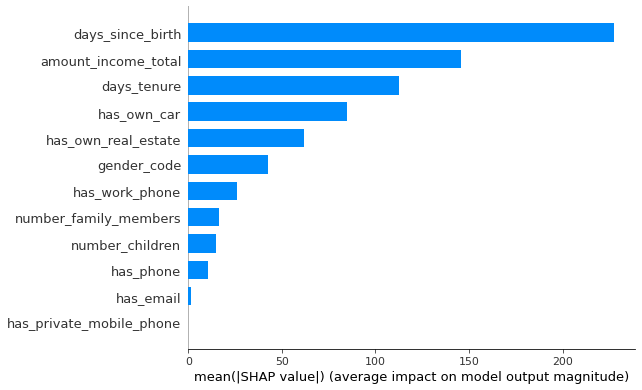

In [21]:
import shap
explainer = shap.TreeExplainer(pipe.steps[0][1])
shap_values = explainer.shap_values(X_train)
shap.summary_plot(shap_values, X_train, plot_type="bar")

In [22]:
# compute SHAP values
explainer = shap.Explainer(pipe.steps[0][1], X_train)
explainer_sv = explainer(X_train)


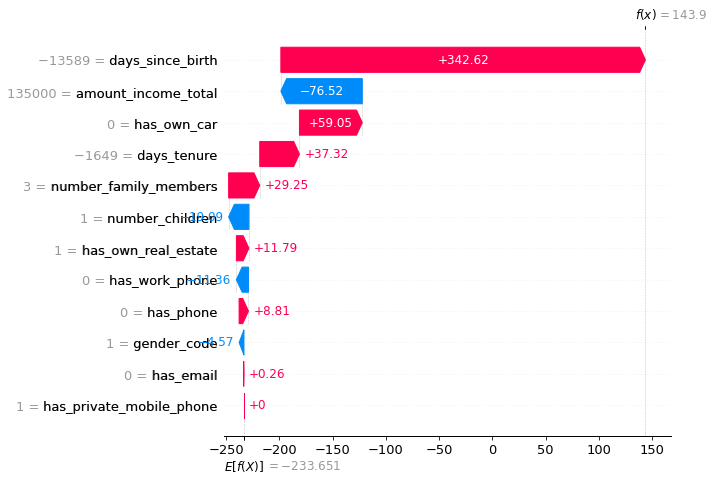

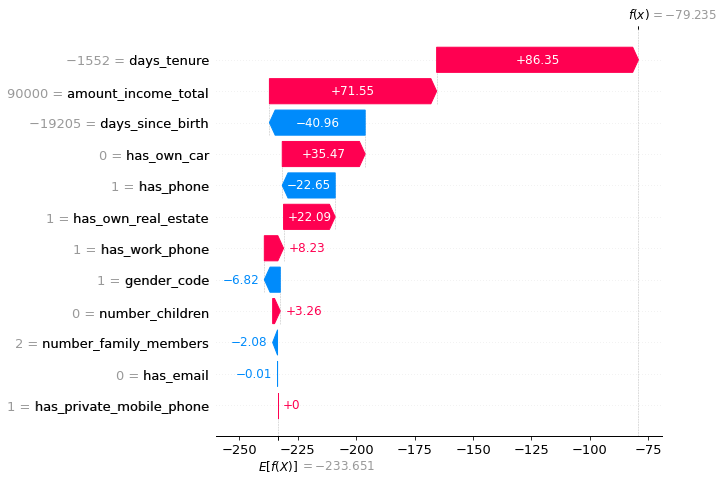

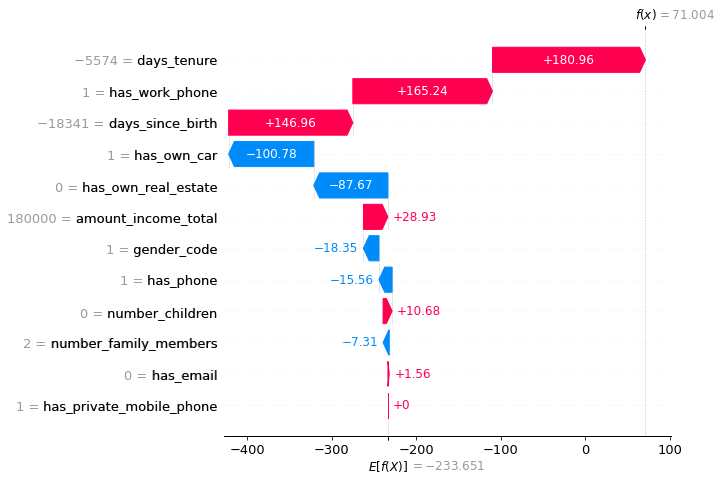

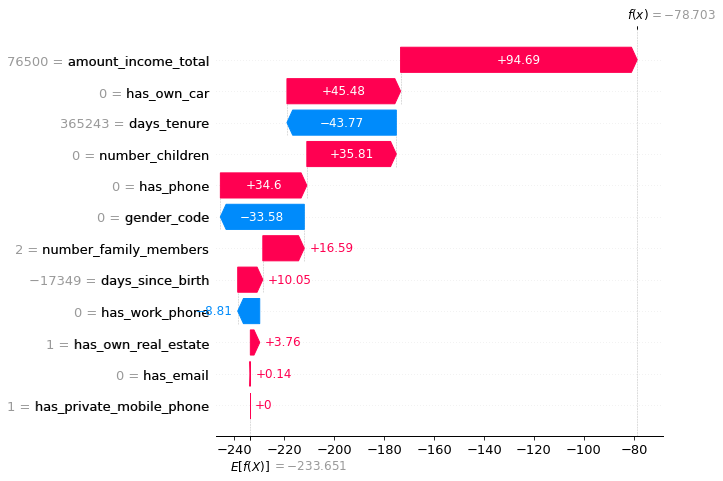

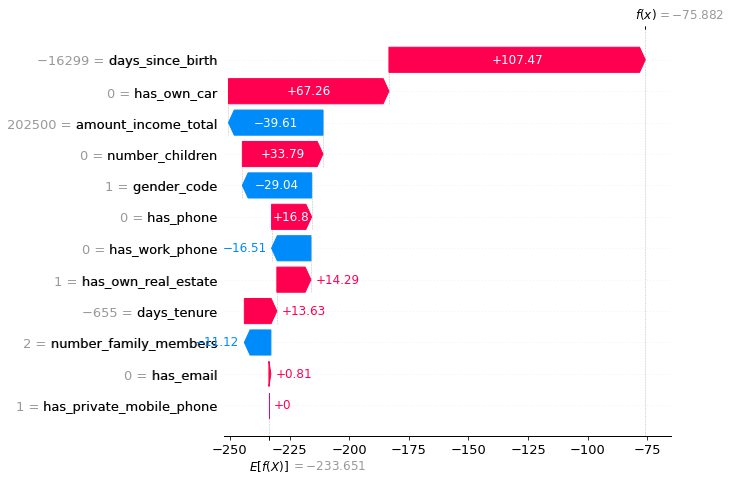

...

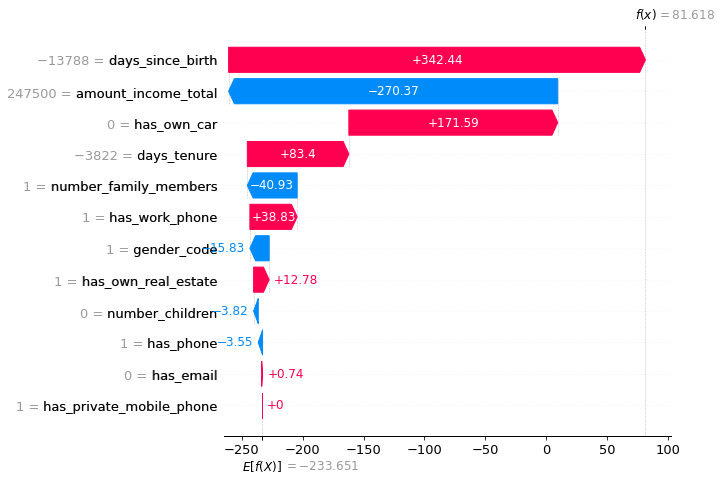

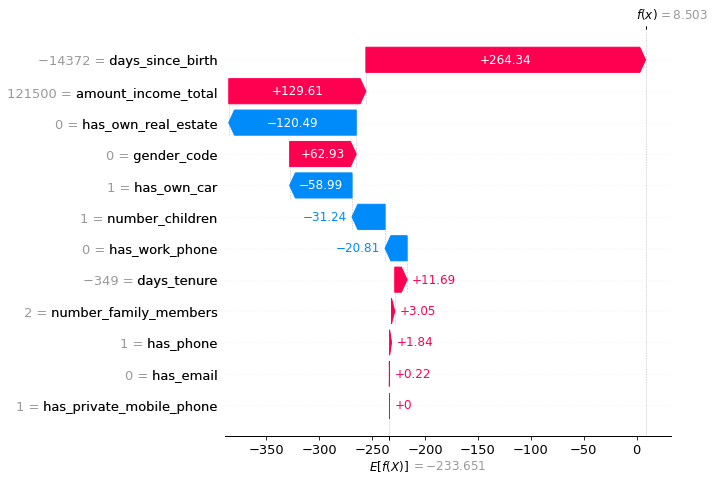

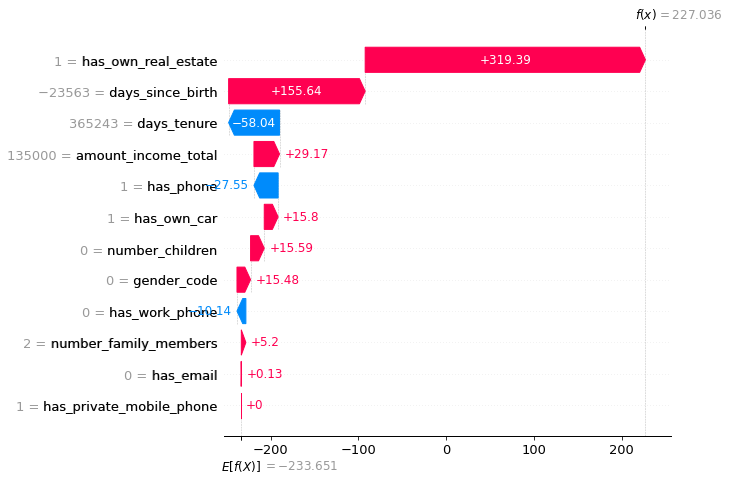

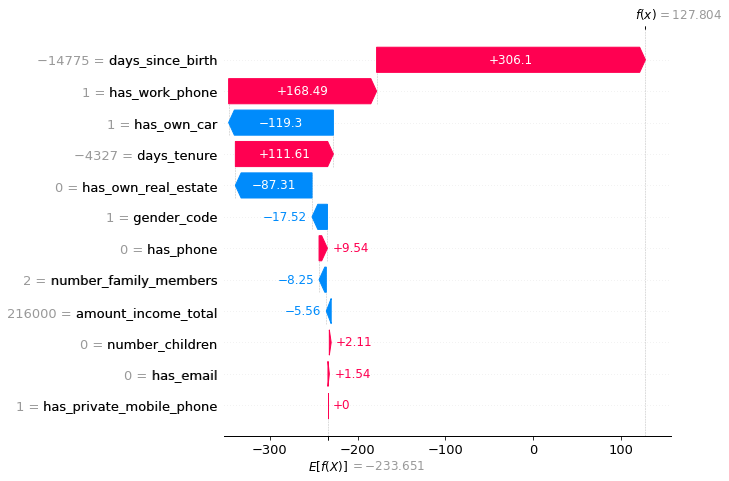

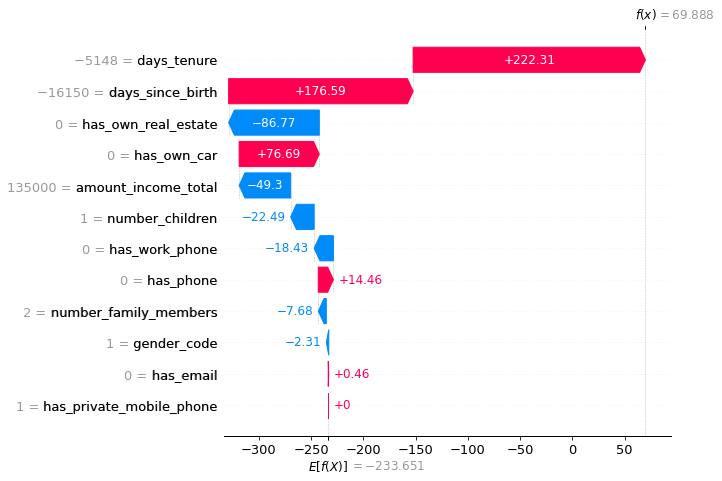

In [23]:
explanations_to_show = 24 # len(explainer_sv)


for i in range(0, explanations_to_show):
    shap.plots.waterfall(explainer_sv[i], max_display=24)


In [24]:
pd.DataFrame(apps.loc[22624])

,22624
id,5067024
gender_code,1
family_status,Married
has_own_car,0
has_own_real_estate,1
amount_income_total,135000.0
income_type,Working
education_type,Secondary / secondary special
housing_type,House / apartment
days_since_birth,-13589


In [25]:
X_train.head()

,gender_code,has_own_car,has_own_real_estate,amount_income_total,days_since_birth,days_tenure,has_private_mobile_phone,has_work_phone,has_phone,has_email,number_children,number_family_members
22624,1,0,1,135000.0,-13589,-1649,1,0,0,0,1,3.0
2838,1,0,1,90000.0,-19205,-1552,1,1,1,0,0,2.0
26797,1,1,0,180000.0,-18341,-5574,1,1,1,0,0,2.0
15339,0,0,1,76500.0,-17349,365243,1,0,0,0,0,2.0
21904,1,0,1,202500.0,-16299,-655,1,0,0,0,0,2.0


In [26]:
y_train.head()

22624    144.0
2838     -79.0
26797     72.0
15339    -79.0
21904    -77.0
Name: customer_lifetime_value, dtype: float64

In [27]:
X_train.columns

Index(['gender_code', 'has_own_car', 'has_own_real_estate',
       'amount_income_total', 'days_since_birth', 'days_tenure',
       'has_private_mobile_phone', 'has_work_phone', 'has_phone', 'has_email',
       'number_children', 'number_family_members'],
      dtype='object')

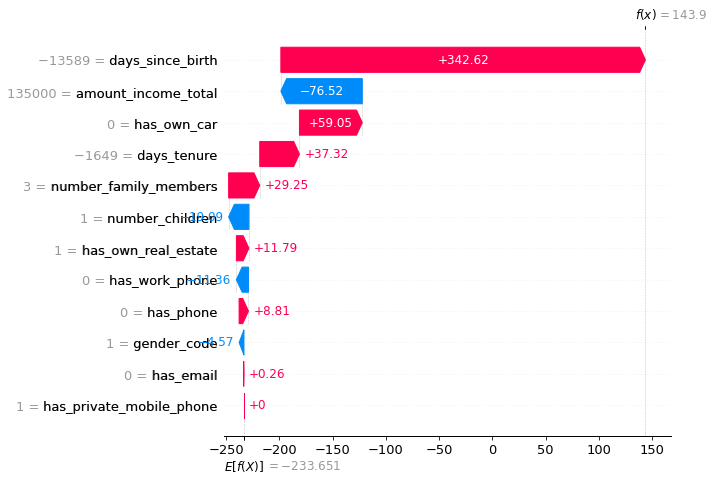

In [28]:
shap.plots.waterfall(explainer_sv[0], max_display=24)


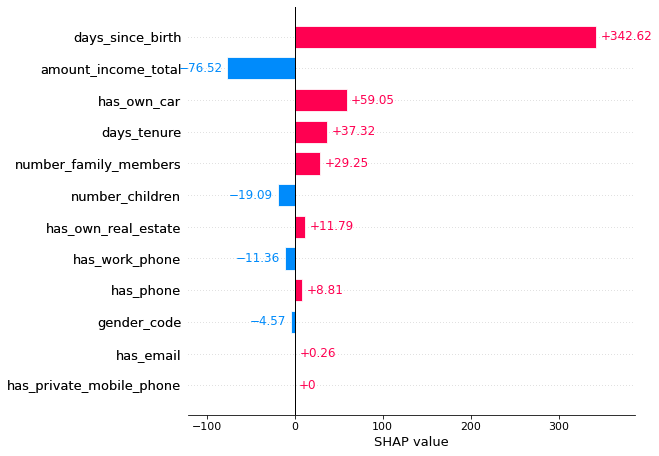

In [29]:
shap.plots.bar(explainer_sv[0], max_display=24)

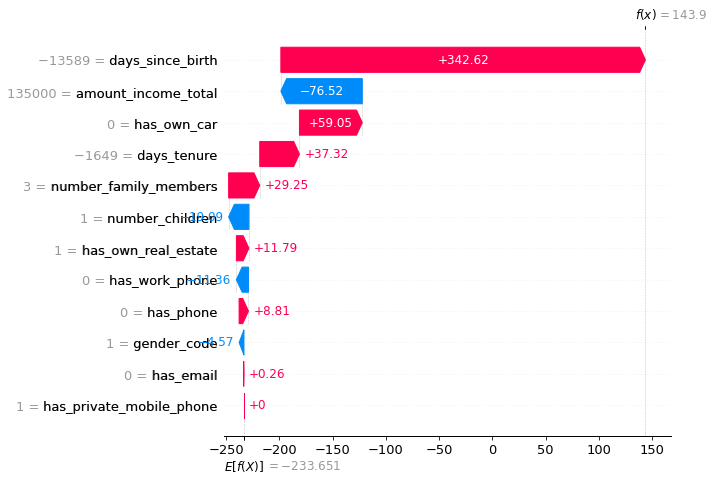

In [30]:
shap.plots.waterfall(explainer_sv[0], max_display=24)

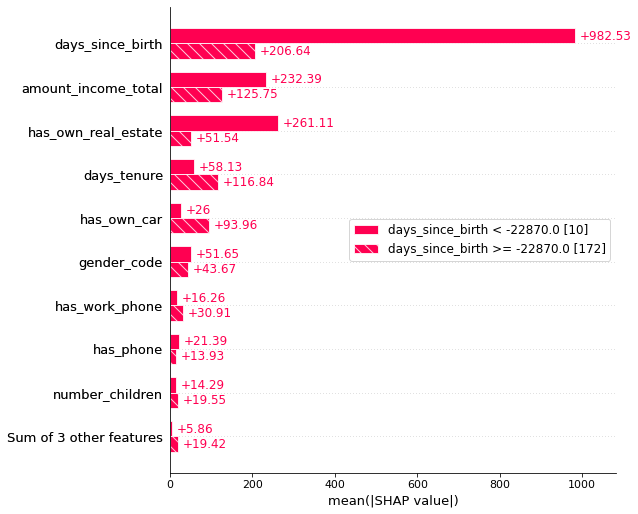

In [31]:
shap.plots.bar(explainer_sv.cohorts(2).abs.mean(0))

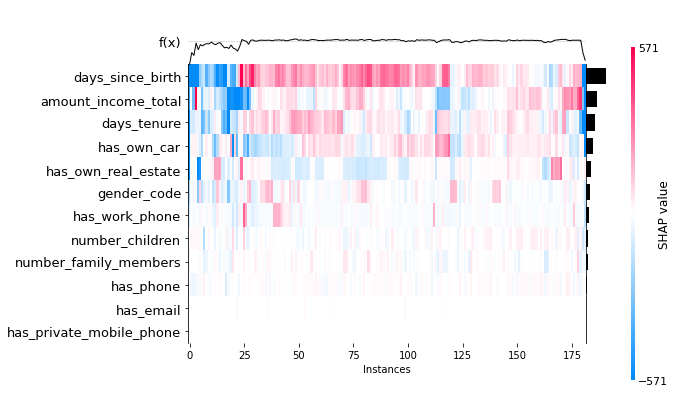

In [32]:
shap.plots.heatmap(explainer_sv, max_display=24)

In [33]:
print("train: {0}, test: {1}, features: {2}".format(len(X_train), len(X_test), X_train.shape[1]))

train: 182, test: 36242, features: 12


In [34]:
X_train.head(20)

,gender_code,has_own_car,has_own_real_estate,amount_income_total,days_since_birth,days_tenure,has_private_mobile_phone,has_work_phone,has_phone,has_email,number_children,number_family_members
22624,1,0,1,135000.0,-13589,-1649,1,0,0,0,1,3.0
2838,1,0,1,90000.0,-19205,-1552,1,1,1,0,0,2.0
26797,1,1,0,180000.0,-18341,-5574,1,1,1,0,0,2.0
15339,0,0,1,76500.0,-17349,365243,1,0,0,0,0,2.0
21904,1,0,1,202500.0,-16299,-655,1,0,0,0,0,2.0
21833,0,0,0,135000.0,-11757,-778,1,0,0,0,0,2.0
1608,1,0,1,103500.0,-22254,365243,1,0,1,0,0,2.0
49298,1,0,1,180000.0,-22228,-686,1,1,1,0,0,2.0
31420,1,0,1,90000.0,-22025,365243,1,0,0,0,0,1.0
44716,1,0,1,157500.0,-12676,-1350,1,0,0,0,1,2.0


In [35]:
model = pipe.steps[0][1]
model.predict(X_test)

array([ -62.654827 ,  105.27579  ,    6.1688766, ..., -372.1925   ,
        -90.76164  ,   34.031372 ], dtype=float32)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


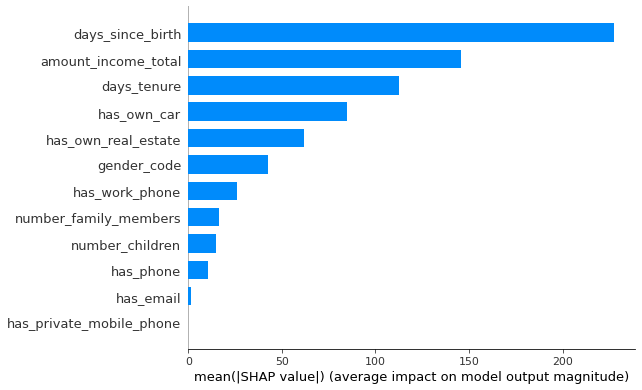

In [36]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)
shap.summary_plot(shap_values, X_train, plot_type='bar')

In [37]:
explainer.expected_value

-285.116